In [ ]:
"""Import everything we need and check gpu"""
%matplotlib inline

already_installed = !pip list -v | grep deeptrack
if not already_installed:
    !pip install deeptrack==0.11.3

import numpy as np
import matplotlib.pyplot as plt
import deeptrack as dt
import os
from google.colab import drive
from numpy.fft import fft2, ifft2, fftshift
from keras import models

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)


In [2]:
#@title
def crop(pupil_radius):
    def inner(image):
        x = np.arange(image.shape[0]) - image.shape[0] / 2
        y = np.arange(image.shape[1]) - image.shape[1] / 2
        X, Y = np.meshgrid(x, y)
        image[X ** 2 + Y ** 2 > pupil_radius ** 2] = 0
        return image
    return inner

def func():
    def inner(image):
        image = (image - 1)
        output = np.zeros((*image.shape[:2], 2))
        output[..., 0:1] = np.real(image)
        output[..., 1:2] = np.imag(image)
        return output
    return inner

def normalization_func():
    def inner(image):
        output = np.zeros((*image.shape[:2], 2))
        output[:,:,0] = image[:,:,0] - np.min(image[:,:,0])
        output[:,:,1] = image[:,:,1] - np.min(image[:,:,1])
        output[:,:,0] = image[:,:,0] / np.max(image[:,:,0])
        output[:,:,1] = image[:,:,1] / np.max(image[:,:,1])
        return output
    return inner

def crop_center(img, cropx, cropy):
    """returns the center of img with size cropx,cropy"""
    y,x = img.shape
    startx = x//2 - cropx//2
    starty = y//2 - cropy//2    
    return img[starty:starty+cropy, startx:startx+cropx]

def get_positions(image):
    "returns a list of coordinates"
    r = lambda x: (round(x[0]), round(x[1]))
    return [r(property["position"]) for property in image.properties  if "position" in property]

def create_sub_images(image, crop, positions, exclude_outliers=False):
    """returns as many sub-images as there are particles in the picture"""
    if exclude_outliers:
        sub_images = np.array([image[pos[0]-crop//2:pos[0]+crop//2,pos[1]-crop//2:pos[1]+crop//2,:] for pos in positions])
        return np.array([image for image in sub_images if image.shape==(crop,crop,2)])
    else:
        padded_image = np.pad(image,[(crop//2,crop//2),(crop//2,crop//2),(0,0)])
        return np.array([padded_image[pos[0]:pos[0]+crop,pos[1]:pos[1]+crop,:] for pos in positions])

def plot_images(image, sub_images, fourier_image_size):
    """Plots the original image as an image as every subparticle"""
    fig, ax = plt.subplots(1, 1, figsize=(10, 10))
    ax.imshow(image[:,:,0])
    ax.set_xlabel("Real part of big image")
    plt.show()
    for img in sub_images:
        ft = fftshift(fft2(img[:,:,0]+1j*img[:,:,1])-np.mean(img[:,:,0]+1j*img[:,:,1]))
        fig, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(1, 6, figsize=(25,8))
        ax1.imshow(img[:,:,0])
        ax2.imshow(img[:,:,1])
        ax3.imshow(crop_center(np.real(ft), fourier_image_size, fourier_image_size))
        ax4.imshow(crop_center(np.imag(ft), fourier_image_size, fourier_image_size))
        ax5.imshow(np.abs(img[:,:,0])**2)
        ax6.imshow(crop_center(np.abs(ft)**2, fourier_image_size, fourier_image_size))
        plt.show()

def load_models(path):
    """Load models and return them in a list"""
    drive.mount('/content/drive')
    return [models.load_model(path+f"/model{i}") for i in range(NUMBER_OF_MODELS)]

def propagate(image, z):
    """Re-propagate the images using PAS"""
    image_size = len(image[:,0,0])
    propagate_up, propagate_down = propagation_matrix(
        [.05, -.05],
        shape=(image_size, image_size),
        padding=0,
        wavelength=optics.wavelength.current_value,
        pixel_size=optics.voxel_size.current_value[0],
        )
    
    ft_image = FourierTransform(padding=0).get(image, padding=0)
    prop_ft_image = FourierTransformTransformation().get(ft_image, propagate_down, propagate_up, z)
    return InverseFourierTransform(padding=0).get(prop_ft_image, padding=0)

def crop_center_list(images, crop_width):
    """calls crop_center iteratively on every image in a list"""
    return np.stack((
        [crop_center(image, crop_width, crop_width) for image in np.array(images)[:,:,:,0]],
        [crop_center(image, crop_width, crop_width) for image in np.array(images)[:,:,:,1]]),
        axis=3,
        )
    
def normalize_images(images):
    """Normalizes every image so that the pixel values falls into the interval (0,1)"""
    normalized = normalization_func()
    return [normalized(image) for image in images]

def focused_images(image, z_positions):
    """returns images with particle roughly in focal plane"""
    r = lambda x: (round(x[0]), round(x[1]))
    positions = [r(property["position"]) for property in test_image.properties  if "position" in property]
    propagated_sub_images = []
    for z, pos in zip(rough_predictions, positions):
        prop_image = propagate(image, -z)
        propagated_sub_images.extend(create_sub_images(prop_image, 64, [pos]))
    return np.array(propagated_sub_images)

def plot_besides(prop_sub_images,sub_images):
    for i in range(len(sub_images)):
        fig, (ax1, ax2) = plt.subplots(1,2,figsize=(5,3))
        ax1.imshow(sub_images[i,:,:,0])
        ax1.set_xlabel("partikel i originalbild")
        ax2.imshow(np.array(prop_sub_images)[i,:,:,0])
        ax2.set_xlabel("partikel efter pas (croppad)")
        plt.show()

In [3]:
"""Define the optics."""
IMAGE_SIZE = 1500
SUB_IMAGE_SIZE = 256
FOURIER_IMAGE_SIZE = 50
NUMBER_OF_PARTICLES = 50
NUMBER_OF_MODELS = 1

HC = dt.HorizontalComa(coefficient=lambda c1: c1, c1=0 + np.random.randn() * 0.05)
VC = dt.VerticalComa(coefficient=lambda c2:c2, c2=0 + np.random.randn() * 0.05)
CROP = dt.Lambda(crop, pupil_radius=IMAGE_SIZE)
complex_to_float = dt.Lambda(func)
normalization = dt.Lambda(normalization_func)

particle = dt.MieSphere(
    position=lambda: SUB_IMAGE_SIZE//2 + (IMAGE_SIZE-SUB_IMAGE_SIZE) * np.random.rand(2),
    z=lambda: -150 + np.random.random() * 300,
    radius=lambda: 1.5e-7 + 3e-7 * np.random.rand() ,
    refractive_index=lambda: np.random.uniform(0, 0.15) + 1.45,
    L=8,
    position_unit="pixel",
)

optics = dt.Brightfield(
    NA=1.3,
    resolution=1.13e-6,
    wavelength=525e-9,
    polarization_angle=lambda: np.random.rand() * 2 * np.pi,
    magnification=10,
    output_region=(0, 0, IMAGE_SIZE, IMAGE_SIZE),
    padding=(64,) * 4,
    return_field=True,
    pupil=HC+VC + CROP,
)

real_noise = dt.Gaussian(
    mu=0, 
    sigma=lambda level: np.random.rand() * 0.05,
)

noise = real_noise + dt.Gaussian(
    mu=0, 
    sigma=lambda real_sigma: real_sigma * 0.05j,
    real_sigma=real_noise.sigma
)

gradient = dt.IlluminationGradient(
    gradient=lambda: np.random.randn(2) * 5e-5,
)

"""Generating sub-images"""
particles = particle ** NUMBER_OF_PARTICLES
multiparticle_dataset = optics(particles + noise + gradient) + complex_to_float
test_image = multiparticle_dataset.update().resolve()
sub_images = create_sub_images(test_image, SUB_IMAGE_SIZE, get_positions(test_image), exclude_outliers=False)

"""Plotting the sub-images of all the particles"""
plot_images(test_image, sub_images, FOURIER_IMAGE_SIZE)

In [ ]:
"""Importing models"""
rough_path = str("/content/drive/My Drive/rough_networks_feb15")
fine_path = str("/content/drive/My Drive/fine_networks_feb15")
rough_model = load_models(rough_path)[0]
fine_model = load_models(fine_path)[0]

In [7]:
#@title 
def _propagate_field(field, Tz, z, x, y, K, C, k=2 * np.pi / 0.633):
    """
    Propagate field. Field =  a Complex array of row*col dimension
    """
    Field = np.fft.fft2(field)
    Field = C * Tz * Field
    Field = np.fft.ifft2(Field)

    return Field


def _precalc(field, px, k=2 * np.pi / 0.633):
    """
    Precalculate some constants for propagating field for faster computations.
    """
    yr, xr = field.real.shape

    x = 2 * np.pi / px * np.arange(-(xr / 2 - 1 / 2), (xr / 2 + 1 / 2), 1) / xr
    y = 2 * np.pi / px * np.arange(-(yr / 2 - 1 / 2), (yr / 2 + 1 / 2), 1) / yr
    KXk, KYk = np.meshgrid(x, y)

    K = np.real(
        np.sqrt(np.array(1 - (KXk / k) ** 2 - (KYk / k) ** 2, dtype=np.complex64))
    )
    # Create a circular disk here.
    C = np.fft.fftshift(((KXk / k) ** 2 + (KYk / k) ** 2 < 1) * 1.0)

    return x, y, K, C


def _precalc_Tz(k, zv, K, C):
    return [C * np.fft.fftshift(np.exp(k * 1j * z * (K - 1))) for z in zv]


def propagation_matrix(
    z,
    shape=(IMAGE_SIZE, IMAGE_SIZE),
    padding=64,
    wavelength=525e-9,
    pixel_size=1.13e-6,
):

    field = np.zeros(np.array(shape) + padding * 2)
    k = 2 * np.pi / wavelength * 1e-6
    x, y, K, C = _precalc(field, pixel_size * 1e6, k)
    return _precalc_Tz(k, z, K, C)


class Rescale(dt.Feature):
    """Rescales an optical field.
    Parameters
    ----------
    i : int
        index of z-propagator matrix
    """

    def __init__(self, rescale=1, **kwargs):
        super().__init__(rescale=rescale, **kwargs)

    def get(self, image, rescale, **kwargs):
        image = np.array(image)
        im=image[...,0]+1j*image[...,1]
        im=(rescale*(np.abs(im)-1)+1)*np.exp(1j*np.angle(im))
        image[..., 0] = im.real
        image[..., 1] = im.imag
        return image
        

    

class RotateField(dt.Feature):
    def __init__(self, angle=0, **kwargs):
        super().__init__(angle=angle, **kwargs)

    def get(self, image, angle, **kwargs):
        image = np.array(image)
        im2=np.copy(image)
        im2[...,0]-=1
        im2[...,0]=np.cos(angle)*image[...,0]+np.sin(angle)*image[...,1]
        im2[...,1]=np.cos(angle)*image[...,1]-np.sin(angle)*image[...,0]
        image=im2
        image[...,0]+=1

        return image

    
class PhaseShift(dt.Feature):
    def __init__(self, angle=0, **kwargs):
        super().__init__(angle=angle, **kwargs)

    def get(self, image, angle, **kwargs):
        image = np.array(image)
        im2=np.copy(image)
        im2[...,0]=np.cos(angle)*image[...,0]-np.sin(angle)*image[...,1]
        im2[...,1]=np.cos(angle)*image[...,1]+np.sin(angle)*image[...,0]
        image=im2

        return image
class RescalePhase(dt.Feature):
    """Rescales the phase of an optical field.
    Parameters
    ----------
    i : int
        index of z-propagator matrix
    """

    def __init__(self, phasescale=1, **kwargs):
        super().__init__(phasescale=phasescale, **kwargs)

    def get(self, image, phasescale, **kwargs):
        image = np.array(image)
        im=image[...,0]+1j*image[...,1]
        im=np.abs(im)*np.exp(1j*phasescale*np.angle(im))
        image[..., 0] = im.real
        image[..., 1] = im.imag

        return image

class FourierTransform(dt.Feature):
    """Creates matrices for propagating an optical field.
    Parameters
    ----------
    i : int
        index of z-propagator matrix
    """

    def __init__(self, padding=(32,32), **kwargs):
        super().__init__(padding=padding, **kwargs)

    def get(self, image, padding, **kwargs):
        im = np.copy(image[..., 0] + 1j * image[..., 1])
        im = np.pad(im, (padding, padding), mode="symmetric")
        f1 = np.fft.fft2(im)
        return f1


class InverseFourierTransform(dt.Feature):
    """Creates matrices for propagating an optical field.
    Parameters
    ----------
    i : int
        index of z-propagator matrix
    """

    def __init__(self, padding=(32,32), **kwargs):
        super().__init__(padding=padding, **kwargs)

    def get(self, image, padding, **kwargs):
        im = np.fft.ifft2(image)
        imnew = np.zeros(
            (image.shape[0] - padding * 2, image.shape[1] - padding * 2, 2)
        )
        imnew[..., 0] = np.real(im)
        imnew[..., 1] = np.imag(im)
        return imnew


class FourierTransformTransformation(dt.Feature):
    def __init__(self, Tz=1, Tzinv=1, i: dt.PropertyLike[int] = 0, **kwargs):
        super().__init__(Tz=Tz, Tzinv=Tzinv, i=i, **kwargs)

    def get(self, image, Tz, Tzinv, i, **kwargs):

        if i < 0:
            propfac=1
            for j in range(int(np.abs(i))):
                propfac*=Tzinv
            image *= propfac
        else:
            propfac=1
            for j in range(int(np.abs(i))):
                propfac*=Tz
            image *= Tz ** i
        return image

True: 28.5     Pred: 8.8      Err: 19.7    
True: 17.4     Pred: 2.8      Err: 14.5    
True: -61.0    Pred: -50.0    Err: -10.9   
True: 40.1     Pred: 44.5     Err: -4.5    
True: -15.8    Pred: -8.5     Err: -7.3    
True: -111.3   Pred: -82.7    Err: -28.6   
True: 103.0    Pred: 70.5     Err: 32.5    
True: 130.4    Pred: 20.2     Err: 110.2   
True: 98.4     Pred: 120.0    Err: -21.6   
True: 15.6     Pred: 10.8     Err: 4.8     
True: 62.6     Pred: 56.2     Err: 6.4     
True: 145.3    Pred: 154.7    Err: -9.4    
True: -126.9   Pred: 8.8      Err: -135.8  
True: 55.8     Pred: 2.4      Err: 53.4    
True: 64.9     Pred: 74.6     Err: -9.7    
True: 57.1     Pred: 74.6     Err: -17.5   
True: -108.2   Pred: -116.9   Err: 8.7     
True: -82.9    Pred: -80.8    Err: -2.1    
True: 105.6    Pred: 128.6    Err: -23.0   
True: -122.9   Pred: -126.9   Err: 4.1     
True: 43.5     Pred: -0.4     Err: 44.0    
True: -38.2    Pred: -21.3    Err: -16.9   
True: 141.1    Pred: 152.5    Er

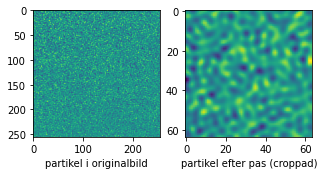

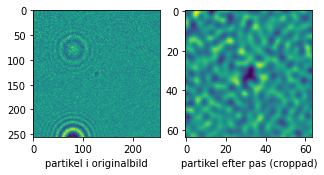

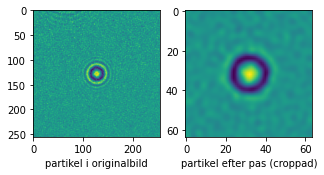

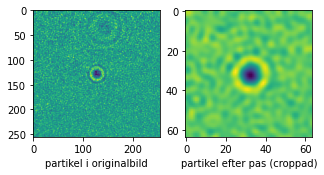

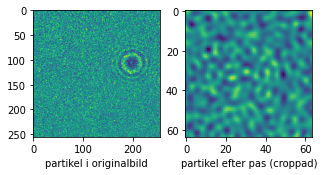

...

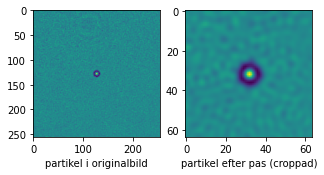

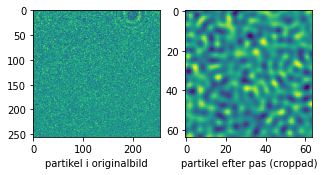

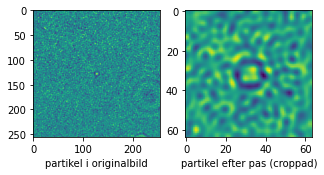

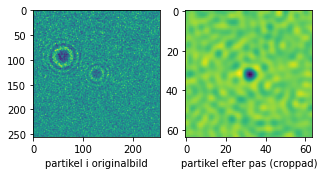

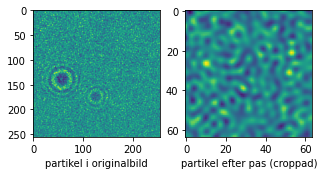

In [8]:
"""Approximating the z-positions of all the particles"""
rough_predictions = rough_model.predict(np.array(sub_images))[:,0]
prop_sub_images = focused_images(test_image, rough_predictions) 

"""Using the re-propagated images to find the 'final' approximation"""
fine_predictions = fine_model.predict(np.array(prop_sub_images))[:,0]
predictions = np.array(fine_predictions) + np.array(rough_predictions)

"""Printing approximations vs ground truth"""
z_positions = np.array([property["z"] for property in test_image.properties  if "position" in property])
for i in range(len(z_positions)):
    print(f"True: {z_positions[i]:<8.1f} Pred: {predictions[i]:<8.1f} Err: {z_positions[i]-predictions[i]:<8.1f}")
    
"""Plotting the original image beside the repropagated image"""
plot_besides(prop_sub_images, sub_images)

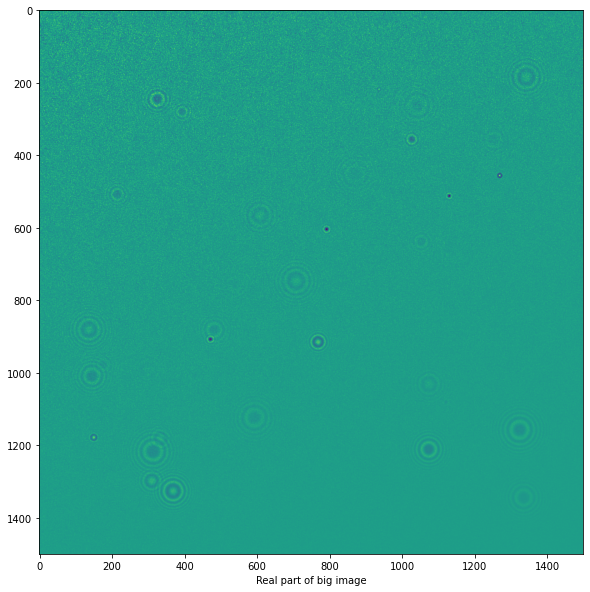

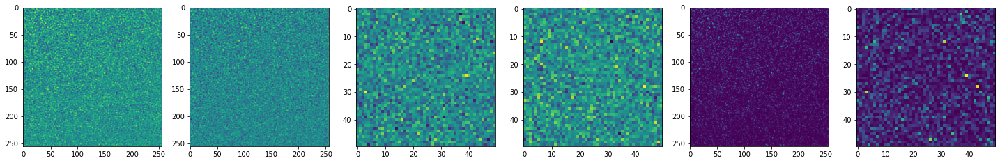

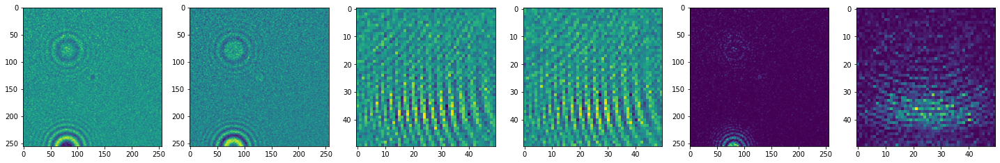

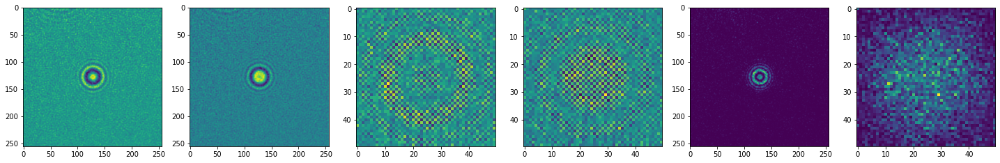

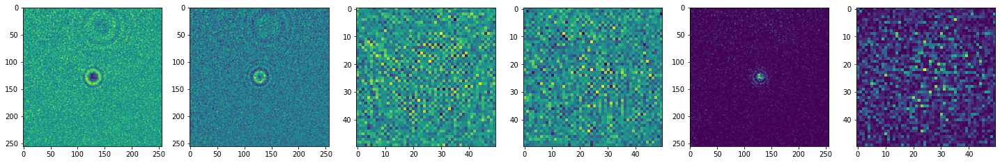

...

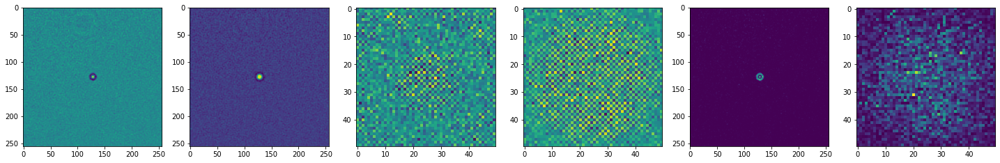

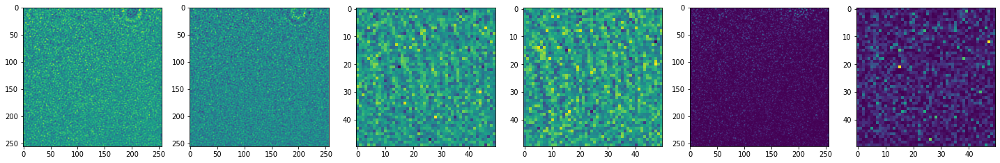

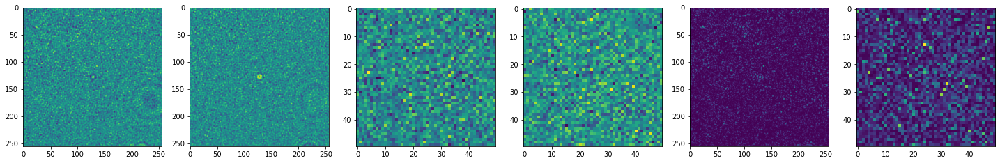

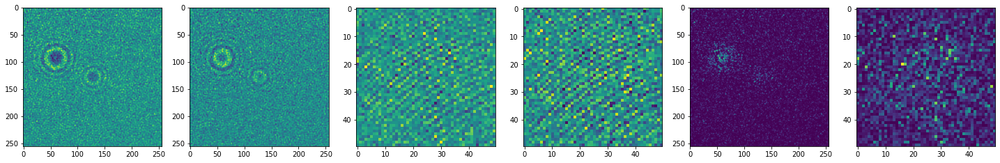

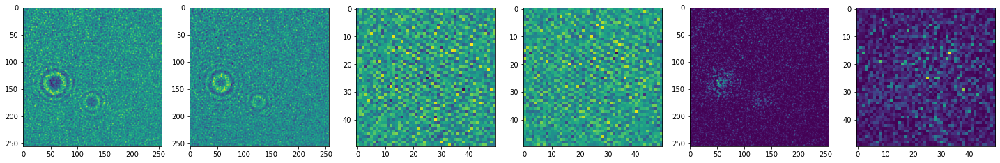

In [9]:
plot_images(test_image, sub_images, FOURIER_IMAGE_SIZE)